In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
import os

# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames[0:5]:
#         print(os.path.join(dirname, filename))
#         break
# Any results you write to the current directory are saved as output.

In [2]:
from fastai.vision.all import *
device='cuda'

In [3]:
path = '/kaggle/input/coco2017'

In [4]:
def get_image_files(path):
    return [f'{path}/{i}' for i in os.listdir(path)]

In [5]:
X = get_image_files(path+'/train2017/train2017')
len(X)

118287

In [6]:
X_train = X[:80000]
X_valid = X[-128:]

In [7]:
def show_sample(path):
    sample_image = plt.imread(path) #using matplotlib
    plt.title(sample_image.shape) #.size gives memory usage, so use .shape
    plt.imshow(sample_image)
    plt.axis("off")
    plt.show()

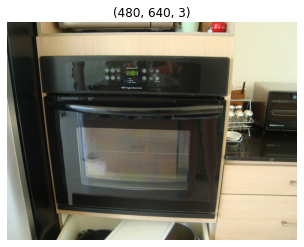

In [8]:
show_sample(X_train[0])

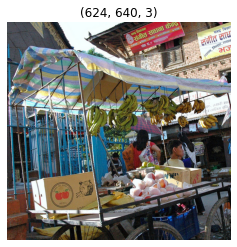

In [9]:

show_sample(X_valid[0])

In [10]:
size = 256
bs = 20

In [11]:
items = X[:20000]
splits = RandomSplitter(0.01, seed=3)(items)
tfms = [[PILImage.create],[PILImage.create]]
dset = Datasets(items=items, tfms=tfms, splits=splits)

In [12]:
item_tfms = [Resize(size), ToTensor()]
batch_tfms = [IntToFloatTensor(), Normalize.from_stats(*imagenet_stats)]
dls = dset.dataloaders(after_item=item_tfms,
                       after_batch=batch_tfms,
                       bs=bs)

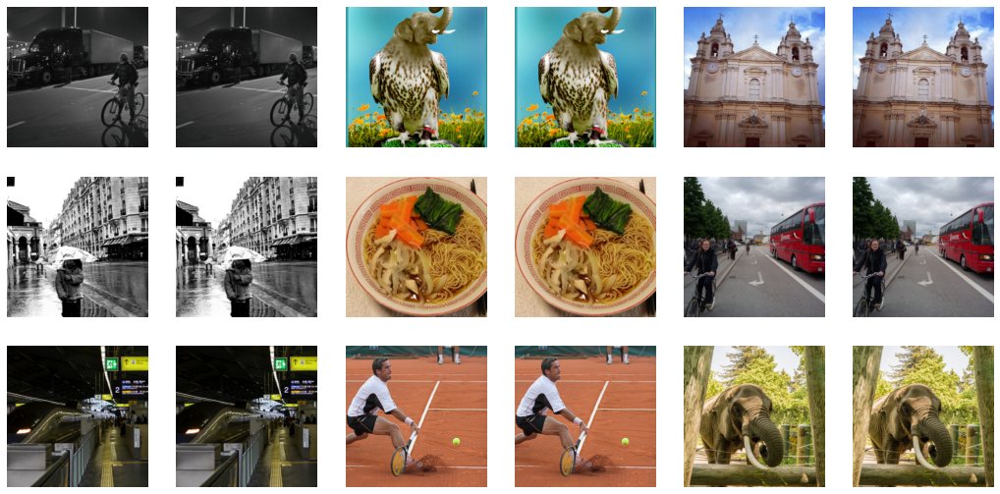

In [13]:
dls.show_batch()

In [14]:
from torchvision.models import vgg19
base_model = vgg19(pretrained=True).features.to(device).eval() #setting vgg19 to eval mode
for p in base_model.parameters(): p.requries_grad=False  #does not keep track of processes for gradients

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

In [15]:
layer_ids = [1, 6, 11, 20, 29, 22]

In [16]:
def get_style_img(name, size, bs):
    '''returns batched and normalized style image for input into vgg model for layer extractions'''
    style_path = f'/kaggle/input/fast-style-transfer/style_transfer/style/{name}.jpg'
    im = PILImage.create(style_path)
    im.show()
    im = RatioResize(size)(im)
    im = ToTensor()(im)
    im = im.unsqueeze(0)
    im = im.repeat([bs,1,1,1]).to(device)
    im = IntToFloatTensor()(im)
    im = Normalize.from_stats(*imagenet_stats)(im)
    return im

In [17]:
class FeatureLoss(Module): 
    def __init__(self, base_model, style_img, layer_ids, style_wgt):
        store_attr()      
        self.extraction_layers = [self.base_model[i] for i in layer_ids]
        self.hooks = hook_outputs(self.extraction_layers, detach=False)
        
    def gram(self, x):
        n, c, h, w = x.shape
        x = x.view(n, c, -1)
        return (x @ x.transpose(1, 2))/(c*w*h)
       
    def get_features(self, x, clone=False):
        self.base_model(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, gen_img, cont_img):
        
        cont_feats = self.get_features(cont_img)
        style_feats = self.get_features(self.style_img, clone=True)
        gen_feats = self.get_features(gen_img)

        gen_img_grams = [self.gram(i) for i in gen_feats[:-1]]
        style_img_grams = [self.gram(i) for i in style_feats[:-1]]
        
        
#         tv_loss =  ( ((gen_img[:,:,1:,:] - gen_img[:,:,:-1,:]).pow(2)).mean() +
#                         ((gen_img[:,:,:,1:] - gen_img[:,:,:,:-1]).pow(2)).mean() ) * 1e-6
        
        cont_loss =  F.mse_loss(gen_feats[-1], cont_feats[-1])  

        style_loss = sum([ F.mse_loss(f_in, f_out) 
                             for f_in, f_out in zip(gen_img_grams, style_img_grams) ] )
        

        return cont_loss + style_loss*self.style_wgt
    
#     def __del__(self): self.hooks.remove()

In [18]:
class TransformerNet(torch.nn.Module):
    def __init__(self):
        super(TransformerNet, self).__init__()
        # Initial convolution layers
        self.conv1 = ConvLayer(3, 32, kernel_size=9, stride=1)
        self.in1 = torch.nn.InstanceNorm2d(32, affine=True)
        self.conv2 = ConvLayer(32, 64, kernel_size=3, stride=2)
        self.in2 = torch.nn.InstanceNorm2d(64, affine=True)
        self.conv3 = ConvLayer(64, 128, kernel_size=3, stride=2)
        self.in3 = torch.nn.InstanceNorm2d(128, affine=True)
        # Residual layers
        self.res1 = ResidualBlock(128)
        self.res2 = ResidualBlock(128)
        self.res3 = ResidualBlock(128)
        self.res4 = ResidualBlock(128)
        self.res5 = ResidualBlock(128)
        # Upsampling Layers
        self.deconv1 = UpsampleConvLayer(128, 64, kernel_size=3, stride=1, upsample=2)
        self.in4 = torch.nn.InstanceNorm2d(64, affine=True)
        self.deconv2 = UpsampleConvLayer(64, 32, kernel_size=3, stride=1, upsample=2)
        self.in5 = torch.nn.InstanceNorm2d(32, affine=True)
        self.deconv3 = ConvLayer(32, 3, kernel_size=9, stride=1)
        # Non-linearities
        self.relu = torch.nn.ReLU()
        
    def forward(self, X):
        y = self.relu(self.in1(self.conv1(X)))
        y = self.relu(self.in2(self.conv2(y)))
        y = self.relu(self.in3(self.conv3(y)))
        y = self.res1(y)
        y = self.res2(y)
        y = self.res3(y)
        y = self.res4(y)
        y = self.res5(y)
        y = self.relu(self.in4(self.deconv1(y)))
        y = self.relu(self.in5(self.deconv2(y)))
        y = self.deconv3(y)
        return y
    
class ConvLayer(torch.nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride):
        super(ConvLayer, self).__init__()
        reflection_padding = kernel_size // 2
        self.reflection_pad = torch.nn.ReflectionPad2d(reflection_padding)
        self.conv2d = torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride)

    def forward(self, x):
        out = self.reflection_pad(x)
        out = self.conv2d(out)
        return out
    
class ResidualBlock(torch.nn.Module):
    """ResidualBlock
    introduced in: https://arxiv.org/abs/1512.03385
    recommended architecture: http://torch.ch/blog/2016/02/04/resnets.html
    """

    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = ConvLayer(channels, channels, kernel_size=3, stride=1)
        self.in1 = torch.nn.InstanceNorm2d(channels, affine=True)
        self.conv2 = ConvLayer(channels, channels, kernel_size=3, stride=1)
        self.in2 = torch.nn.InstanceNorm2d(channels, affine=True)
        self.relu = torch.nn.ReLU()

    def forward(self, x):
        residual = x
        out = self.relu(self.in1(self.conv1(x)))
        out = self.in2(self.conv2(out))
        out = out + residual
        return out
    
class UpsampleConvLayer(torch.nn.Module):
    """UpsampleConvLayer
    Upsamples the input and then does a convolution. This method gives better results
    compared to ConvTranspose2d.
    ref: http://distill.pub/2016/deconv-checkerboard/
    """

    def __init__(self, in_channels, out_channels, kernel_size, stride, upsample=None):
        super(UpsampleConvLayer, self).__init__()
        self.upsample = upsample
        reflection_padding = kernel_size // 2
        self.reflection_pad = torch.nn.ReflectionPad2d(reflection_padding)
        self.conv2d = torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride)

    def forward(self, x):
        x_in = x
        if self.upsample:
            x_in = torch.nn.functional.interpolate(x_in, mode='nearest', scale_factor=self.upsample)
        out = self.reflection_pad(x_in)
        out = self.conv2d(out)
        return out

In [19]:
model = TransformerNet().to(device)

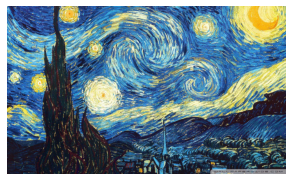

In [20]:
style_img = get_style_img('starry', size, bs)
style_wgt = 3e5
loss_func = FeatureLoss(base_model, style_img, layer_ids, style_wgt)
learn = Learner(dls, model, loss_func=loss_func, path='.')

SuggestedLRs(lr_min=0.00036307806149125097, lr_steep=0.0014454397605732083)

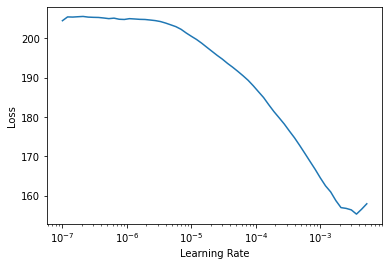

In [21]:
learn.lr_find()

In [22]:
learn.fit_one_cycle(1,1e-3)

epoch,train_loss,valid_loss,time
0,21.316376,20.952095,17:14


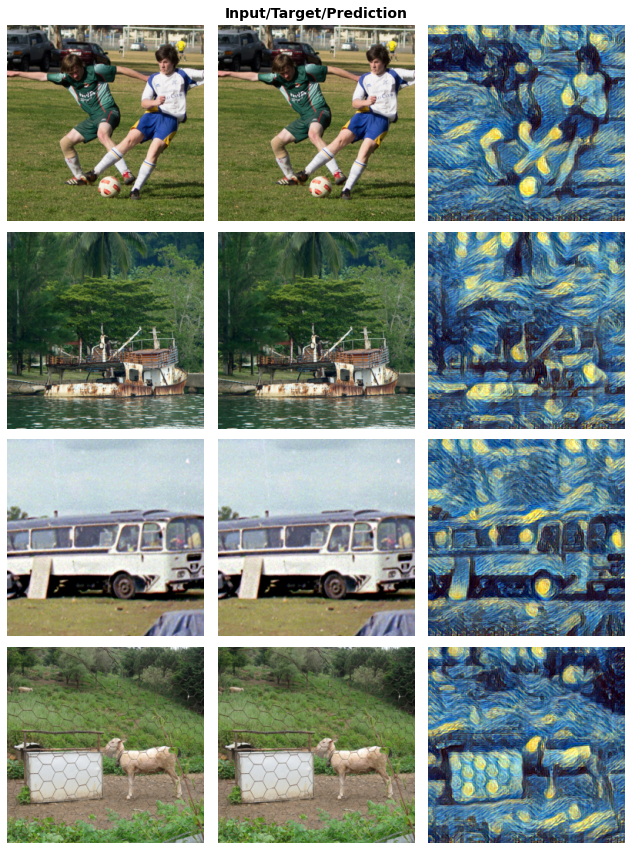

In [23]:
learn.show_results(max_n=4)
plt.tight_layout()

In [24]:
learn.export()

In [25]:
def show_a_result(path, fi, learner):
    print('Showing Results with fine-ness factor: ', fi)
    learner.dls.valid.after_item  = Pipeline([RatioResize(int(256*fi)), ToTensor()])
    
    img = PILImage.create(path)
    orig_size = img.size
    
    pred_img = learner.predict(img)[0] #img tensor c,h,w uint8 format
    pred_img = PILImage.create(pred_img).resize(orig_size) #PIL Image
    
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,1)
    plt.imshow(img)
    plt.title('Original Image', fontsize=20)

    plt.subplot(1,2,2)
    plt.imshow(pred_img)
    plt.title(f'Styled Image at fine-ness: {fi}', fontsize=20)
    plt.show()
    

Showing Results with fine-ness factor:  2.0


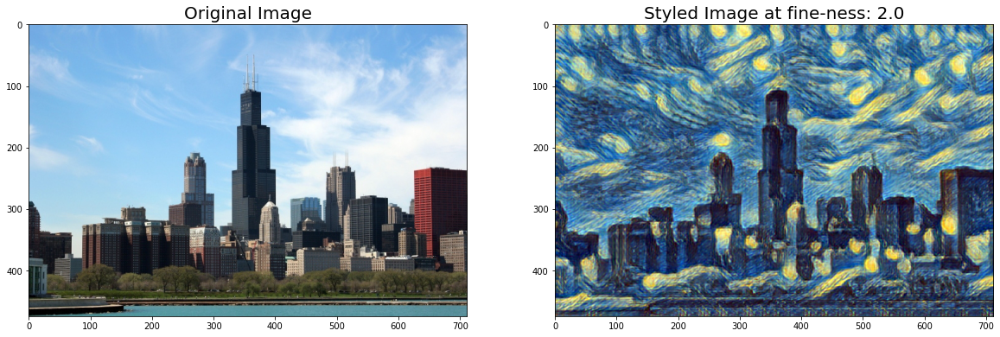

Showing Results with fine-ness factor:  1.2


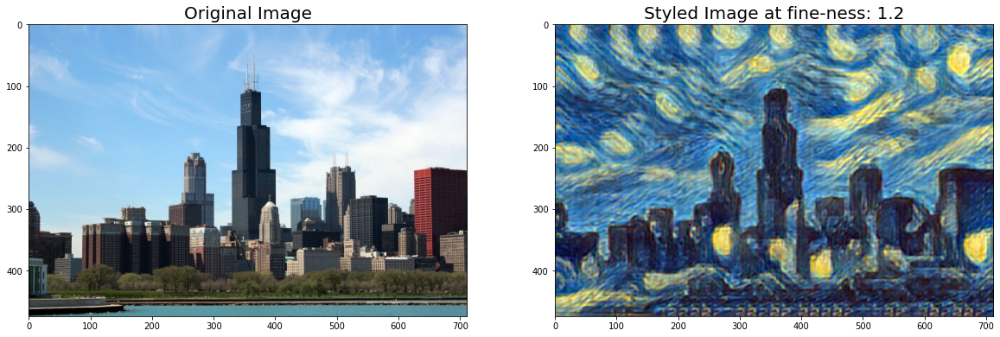

Showing Results with fine-ness factor:  0.8


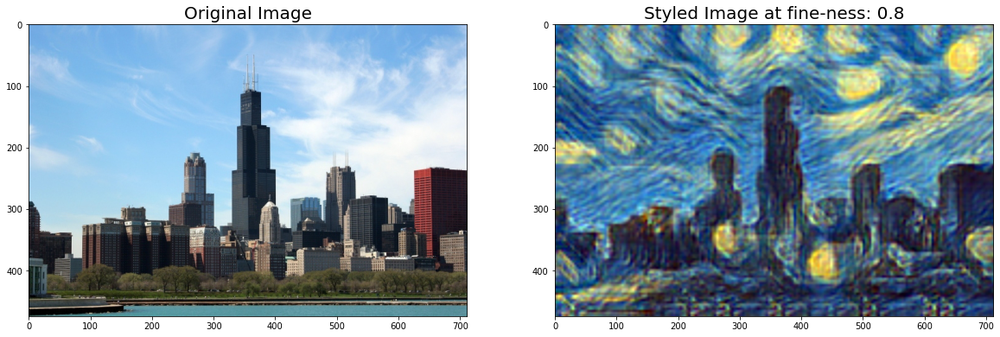

In [26]:
path = '../input/fast-style-transfer/style_transfer/object/chicago.jpg'
fi = 2.0
show_a_result(path, fi, learn)
fi = 1.2
show_a_result(path, fi, learn)
fi = 0.8
show_a_result(path, fi, learn)

Showing Results with fine-ness factor:  2.0


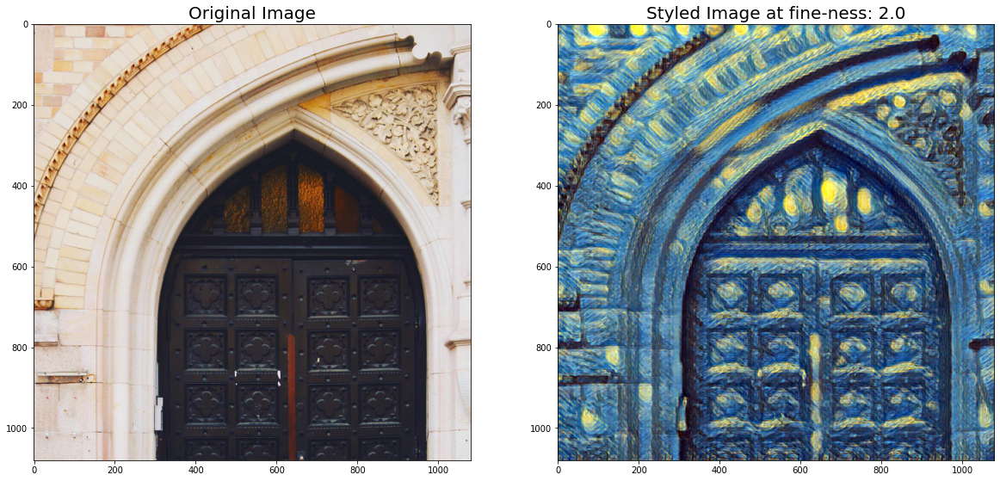

Showing Results with fine-ness factor:  1.2


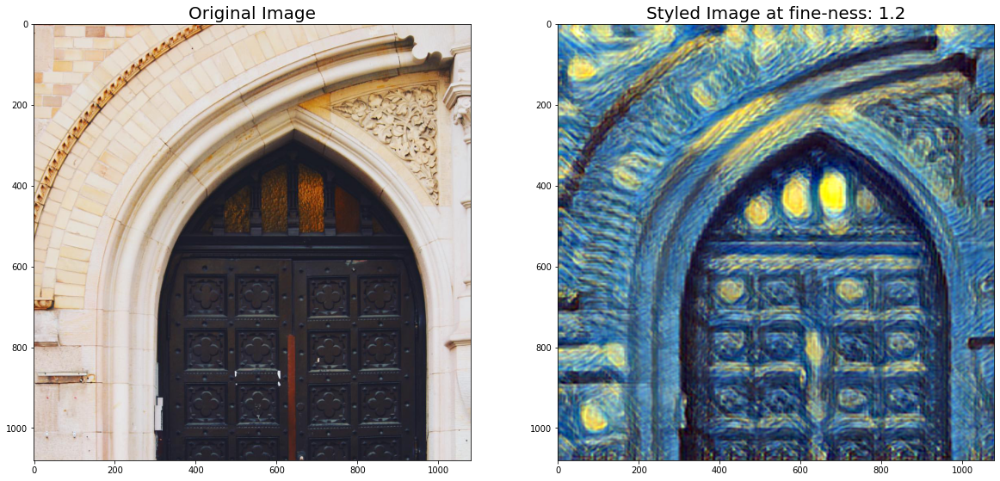

Showing Results with fine-ness factor:  0.8


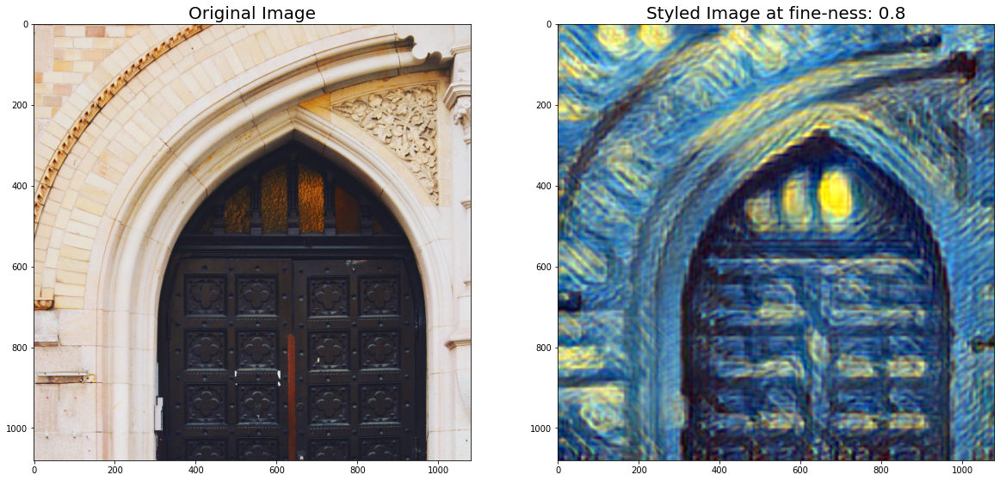

In [27]:
path = '../input/fast-style-transfer/style_transfer/object/object.jpeg'
fi = 2.0
show_a_result(path, fi, learn)
fi = 1.2
show_a_result(path, fi, learn)
fi = 0.8
show_a_result(path, fi, learn)

In [28]:
dls = dset.dataloaders(after_item=item_tfms,
                       after_batch=batch_tfms,
                       bs=bs)

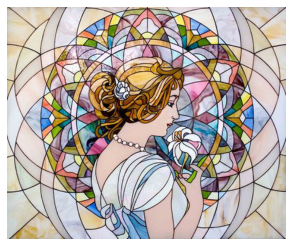

In [29]:
style_img = get_style_img('mosaic', size, bs)
style_wgt = 1e5
loss_func = FeatureLoss(base_model, style_img, layer_ids, style_wgt)
learn = Learner(dls, model, loss_func=loss_func, path='.')

epoch,train_loss,valid_loss,time
0,30.491093,30.206549,18:33


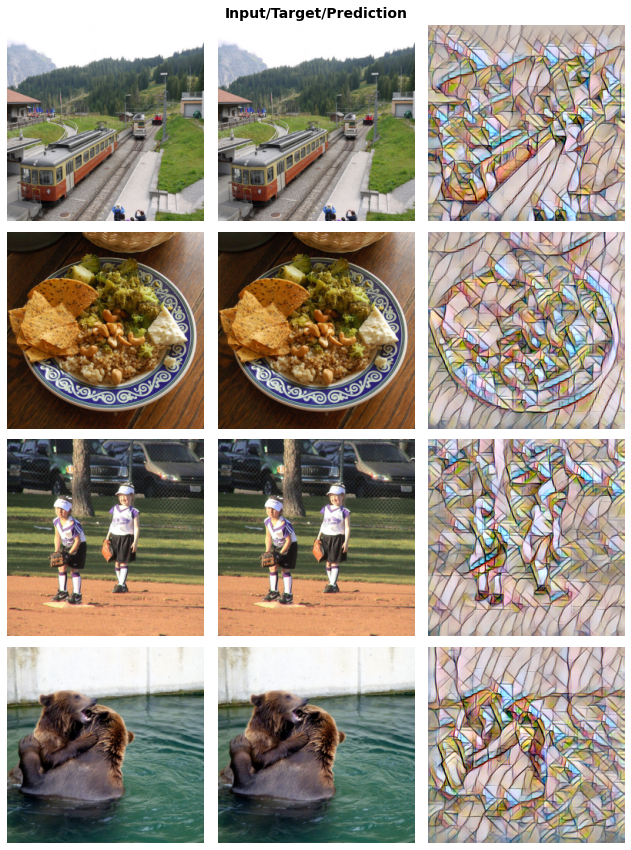

In [30]:
learn.fit_one_cycle(1,1e-3)
learn.show_results(max_n=4)
plt.tight_layout()

Showing Results with fine-ness factor:  2.0


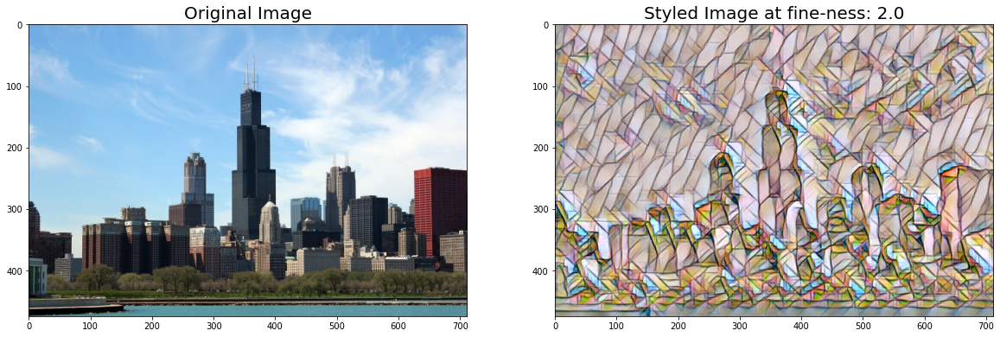

Showing Results with fine-ness factor:  1.2


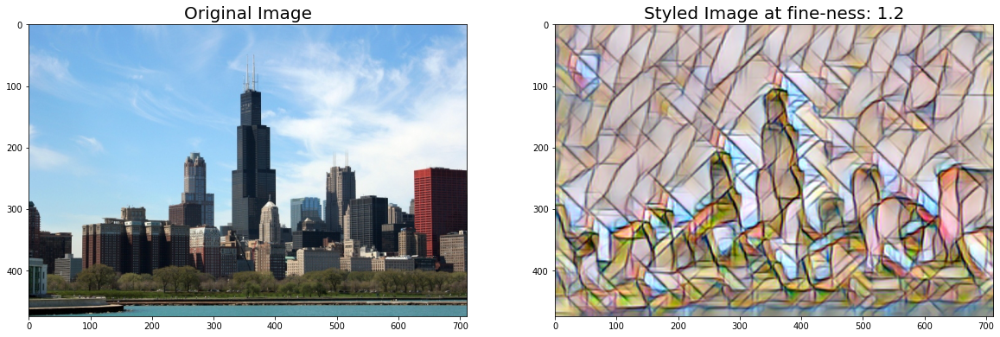

Showing Results with fine-ness factor:  0.8


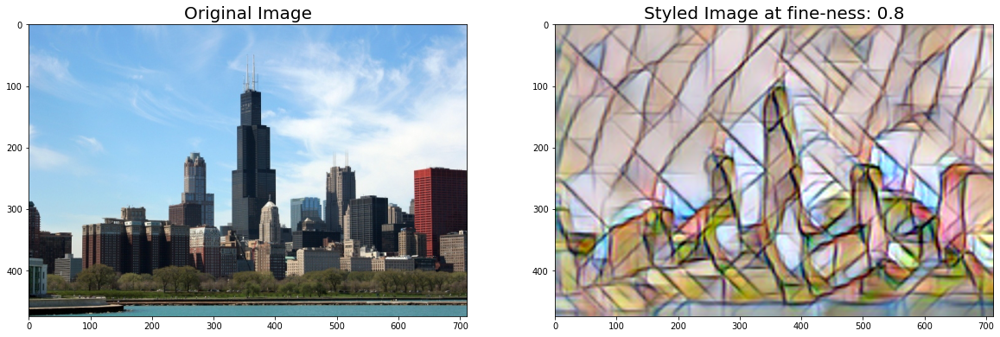

In [31]:
path = '../input/fast-style-transfer/style_transfer/object/chicago.jpg'
fi = 2.0
show_a_result(path, fi, learn)
fi = 1.2
show_a_result(path, fi, learn)
fi = 0.8
show_a_result(path, fi, learn)

Showing Results with fine-ness factor:  2.0


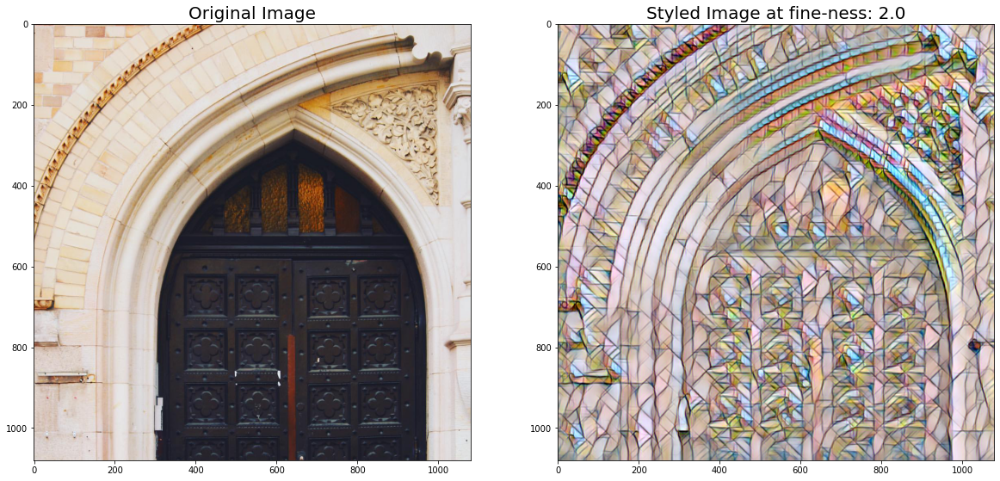

Showing Results with fine-ness factor:  1.2


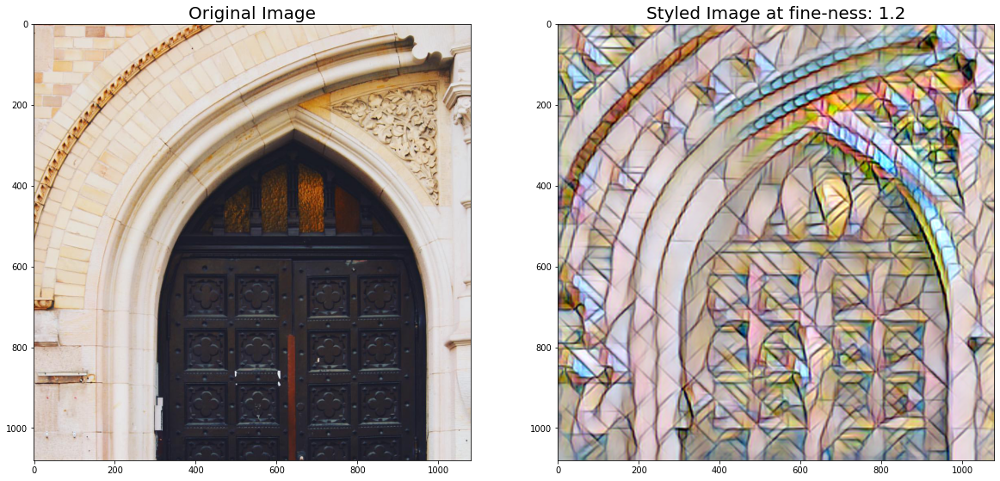

Showing Results with fine-ness factor:  0.8


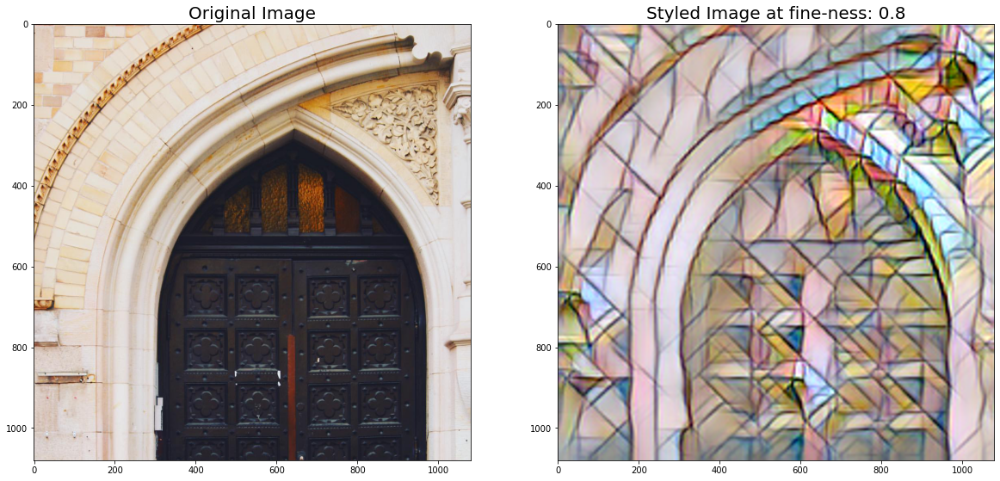

In [32]:
path = '../input/fast-style-transfer/style_transfer/object/object.jpeg'
fi = 2.0
show_a_result(path, fi, learn)
fi = 1.2
show_a_result(path, fi, learn)
fi = 0.8
show_a_result(path, fi, learn)

In [33]:
dls = dset.dataloaders(after_item=item_tfms,
                       after_batch=batch_tfms,
                       bs=bs)

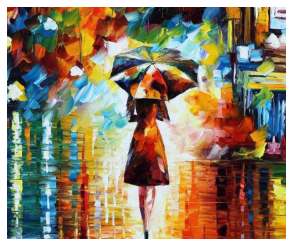

In [34]:
style_img = get_style_img('style', size, bs)
style_wgt = 2e5
loss_func = FeatureLoss(base_model, style_img, layer_ids, style_wgt)
learn = Learner(dls, model, loss_func=loss_func, path='.')

epoch,train_loss,valid_loss,time
0,23.180090,22.876450,18:33


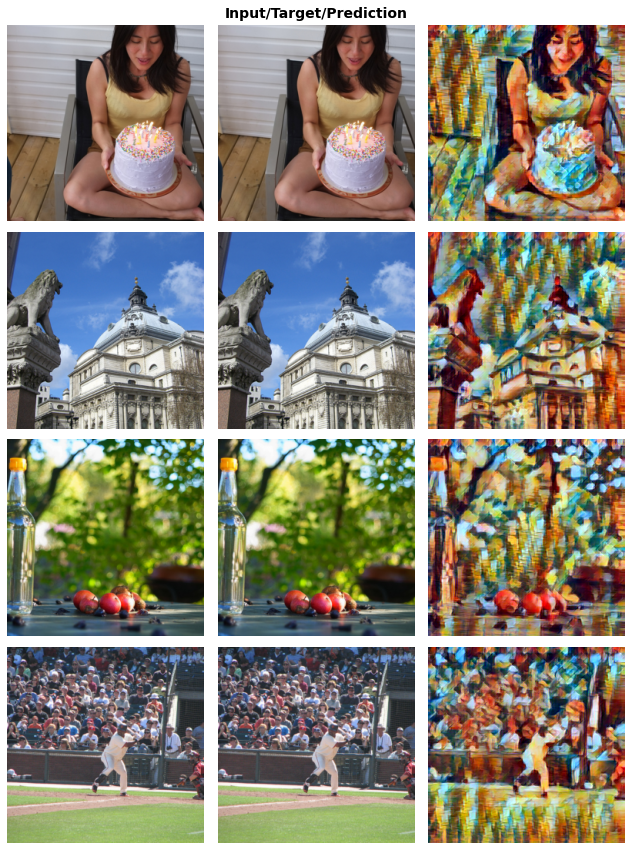

In [35]:
learn.fit_one_cycle(1,1e-3)
learn.show_results(max_n=4)
plt.tight_layout()

Showing Results with fine-ness factor:  2.0


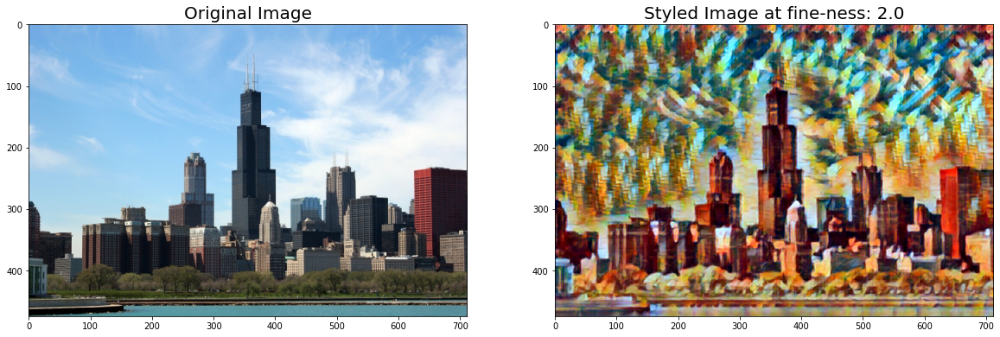

Showing Results with fine-ness factor:  1.2


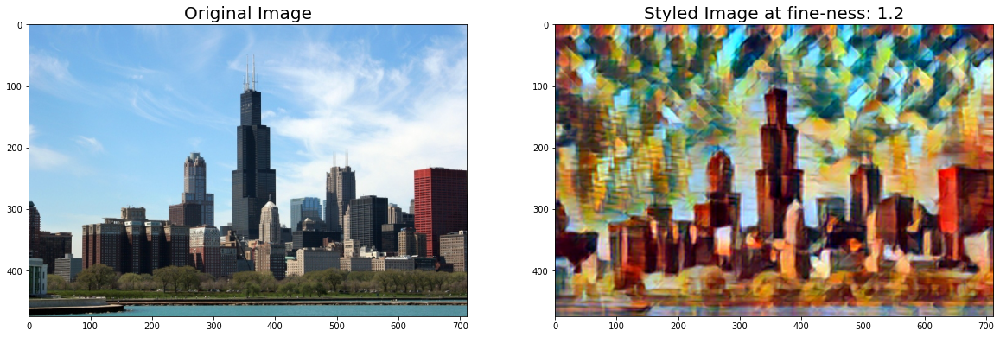

Showing Results with fine-ness factor:  0.8


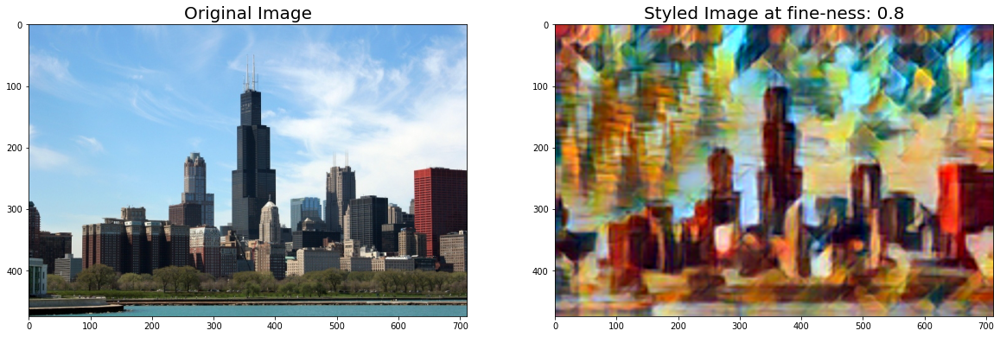

In [36]:
path = '../input/fast-style-transfer/style_transfer/object/chicago.jpg'
fi = 2.0
show_a_result(path, fi, learn)
fi = 1.2
show_a_result(path, fi, learn)
fi = 0.8
show_a_result(path, fi, learn)

Showing Results with fine-ness factor:  2.0


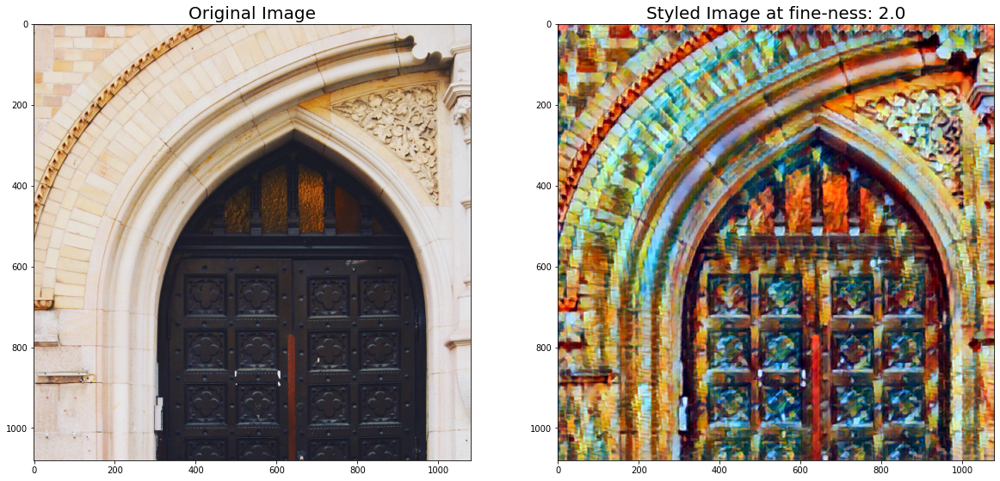

Showing Results with fine-ness factor:  1.2


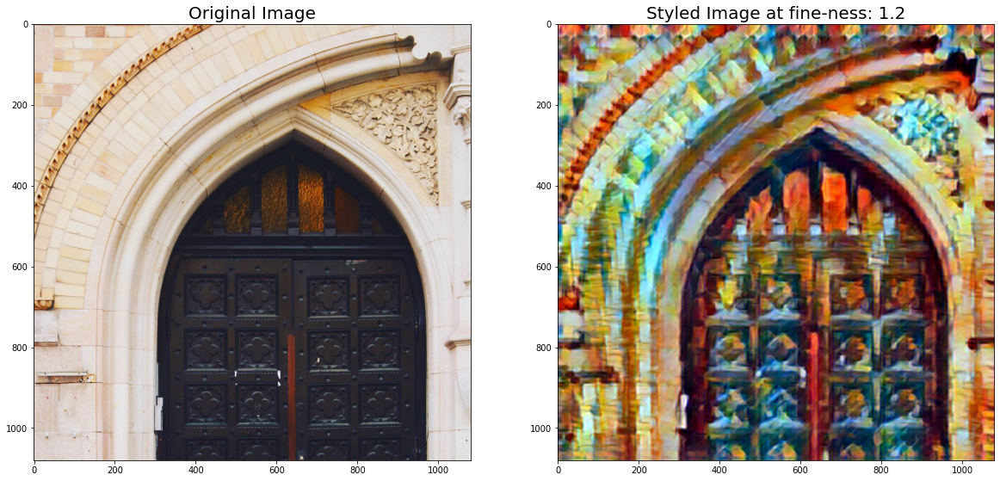

Showing Results with fine-ness factor:  0.8


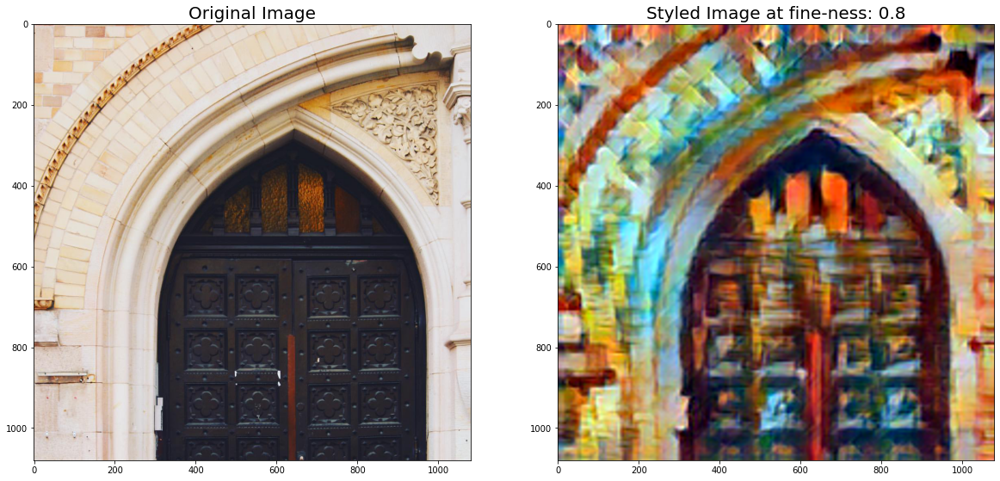

In [37]:
path = '../input/fast-style-transfer/style_transfer/object/object.jpeg'
fi = 2.0
show_a_result(path, fi, learn)
fi = 1.2
show_a_result(path, fi, learn)
fi = 0.8
show_a_result(path, fi, learn)

In [38]:
# learner = load_learner('./export.pkl')
# learner.load('/kaggle/input/style-transfer-10/starry256', device='cpu', with_opt=False)

# f1 = 1.0
# learner.dls.valid.after_item  = Pipeline([RatioResize(int(256*fi)), ToTensor()])

# img = PILImage.create(X[0])
# orig_size = img.size

# pred_img = learner.predict(img)[0] #img tensor c*h*w
# pred_img = PILImage.create(pred_img).resize(orig_size) #PIL Image
# pred_img_bytes = pred_img.to_bytes_format() # bytes image
# img_str = base64.b64encode(pred_img_bytes).decode() # str image
# img_str = "data:image/png;base64," + img_str
# img_str #  return templates.TemplateResponse('output.html', {'request' : request, 'b64val' : img_str})